In [2]:
using LinearAlgebra
using Symbolics
using Catalyst
using Plots
using LaTeXStrings
using Distributions
using ForwardDiff

5.2 Learning using argmin method

5.2.1 Using argmin on A<->B

In [3]:
crn1 = @reaction_network begin
    k, A --> B
    1.0, B --> A
end

Model ##ReactionSystem#230
States (2):
  A(t)
  B(t)
Parameters (1):
  k

In [12]:
# Function that will generate stationary distribution for given k and N for the above CRN (Taken from Chapter 3)
function mctt_for_crn1(k::T, N::Int64) where T<:Real
    states = N + 1
    P = zeros(T, states, states)
    for i in 1:states, j in 1:states
        P[i, j] = 0.0
    end
    for i in 0:N
        if i < N
            P[i+1, i+2] = 1 * (N - i)
        end
        if i > 0
            P[i+1, i] = k * i
        end
        P[i+1, i+1] = - (k * i + 1 * (N - i))
    end
    n=states
    z = Vector{T}(undef, n)
    for i in 1:n
        rows = collect(1:n) .!= i
        cols = collect(1:n) .!= i
        minor = P[rows, cols]
        z[i] = det(minor)
    end
    s = sum(z)
    return z ./ s   
end
#Taking true data as k=10 and N=8
true_data = mctt_for_crn1(10.0,8) 

9-element Vector{Float64}:
 0.4665073802097335
 0.37320590416778676
 0.13062206645872534
 0.026124413291745086
 0.0032655516614681465
 0.00026124413291746013
 1.3062206645880068e-5
 3.732059041740502e-7
 4.665073807467891e-9

Defining KL-divergence as objective function

In [13]:
function kl_divergence(true_data, model_data)
    # Normalize both distributions
    true_data = true_data / sum(true_data)
    model_data = model_data / sum(model_data)
    true_data = max.(true_data,1e-10)
    model_data = max.(model_data, 1e-10)
    # Calculate KL divergence
    divergence = sum(true_data .* log.(true_data ./ model_data))
    return divergence
end


kl_divergence (generic function with 1 method)

Finding Optimal parameter k using argmin method while brute forcing on some specific range of k

Best value of k: 10.01
Minimum KL divergence: 3.301582276226466e-7


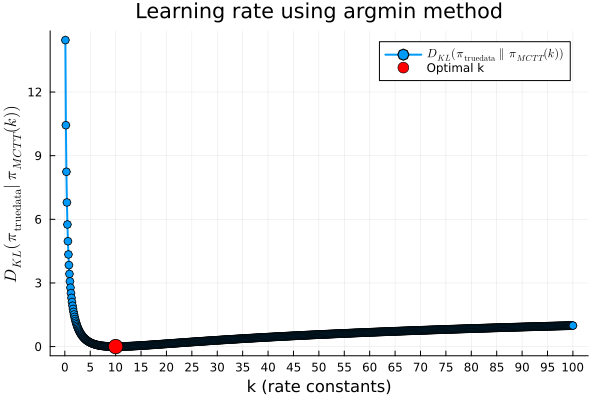

In [14]:
results_brute_force = []
#Computing stationary distributions for a range of k values spanned from 0.01 to 100.00
for t in 1:1000
    k=0.01+t*0.1
    model_data = mctt_for_crn1(k, 8)
    
    divergence = kl_divergence(true_data, model_data)
    
    push!(results_brute_force, (k, divergence))
end
best_k, best_divergence = argmin([r[2] for r in results_brute_force]), minimum([r[2] for r in results_brute_force])
best_k = results_brute_force[best_k][1]

println("Best value of k: ", best_k)
println("Minimum KL divergence: ", best_divergence)

k_values = [r[1] for r in results_brute_force]
divergence_values = [r[2] for r in results_brute_force]

plot(k_values, divergence_values, xticks=0:5:100, marker=:o, xlabel="k (rate constants)", ylabel=L"D_{KL}(\pi_{\mathrm{true data}}\| \pi_{MCTT}(k))", title="Learning rate using argmin method", label=L"D_{KL}(\pi_{\mathrm{true data}} \parallel \pi_{MCTT}(k))", lw=2, legend=:topright)
scatter!([best_k], [best_divergence], color=:red, label="Optimal k", marker=:circle, markersize=8)

Finding Optimal parameter using argmin method while assuming parameter comes from some distribution (we can take any distribution, as in the end we are going to realize that argmin method is not reliable).

Best value of k: 428.0
Minimum KL divergence: 1.987226189937188


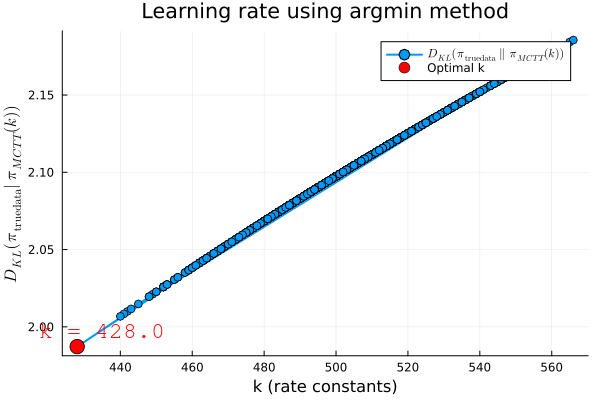

In [15]:
poisson_dist = Poisson(500)
results_poisson = []
for t in 1:1000
    k=float(rand(poisson_dist))
    model_predictions = mctt_for_crn1(k, 8)
    
    divergence = kl_divergence(true_data, model_predictions)
    
    push!(results_poisson, (k, divergence))
end

best_k, best_divergence = argmin([r[2] for r in results_poisson]), minimum([r[2] for r in results_poisson])
best_k = results_poisson[best_k][1]

println("Best value of k: ", best_k)
println("Minimum KL divergence: ", best_divergence)

k_values = [r[1] for r in results_poisson]
divergence_values = [r[2] for r in results_poisson]

plot(k_values, divergence_values, marker=:o, xlabel="k (rate constants)", ylabel=L"D_{KL}(\pi_{\mathrm{true data}}\| \pi_{MCTT}(k))", title="Learning rate using argmin method", label=L"D_{KL}(\pi_{\mathrm{true data}} \parallel \pi_{MCTT}(k))", lw=2, legend=:topright)
scatter!([best_k], [best_divergence], color=:red, label="Optimal k", marker=:circle, markersize=8)
annotate!(best_k + 7, best_divergence + 0.01, text("k = $(round(best_k, digits=2))", :red, :bold, 12))

5.2.2 Using argmin on Enzyme-Catalysis: E+S<->ES

In [16]:
crn_ecr = @reaction_network begin
    k, E + S --> ES
    1.0, ES --> E + S
end

Model ##ReactionSystem#248
States (3):
  E(t)
  S(t)
  ES(t)
Parameters (1):
  k

In [50]:
# Function that will generate stationary distribution for given k and N for the above CRN (Taken from Chapter 3)
function mctt_for_crn_ecr(k::T, N::Int64, M::Int64) where T<:Real
    M=4
    Z=Int64((N-M)/2)
    # For demonstration, let's assume the model predicts a uniform distribution
    states = Z + 1
    P = zeros(T, states, states)
    for i in 0:Z
        if i < Z
            P[i+1, i+2] = (Z-i)
        end
        if i > 0
            P[i+1, i] =  k*i*(i+M)# Pi,i-1
        end
        P[i+1, i+1] = -(1*(Z-i)+k*i*(i+M))
    end
    n=Z+1
    z = Vector{T}(undef, n)
    for i in 1:n
        rows = collect(1:n) .!= i
        cols = collect(1:n) .!= i
        minor = P[rows, cols]
        z[i] = det(minor)
    end
    s = sum(z)
    return z ./ s 
end
#Taking true data as k=10, N=12 and M=8
true_data = mctt_for_crn_ecr(10.0,12,4)

5-element Vector{Float64}:
 0.9241980972411532
 0.07393584777929227
 0.0018483961944823083
 1.760377328078486e-5
 5.501179150309591e-8

Using Bruteforcing over a range of (0.01,100.00) for optimal k

Best value of k: 10.01
Minimum KL divergence: 3.767731166757262e-8


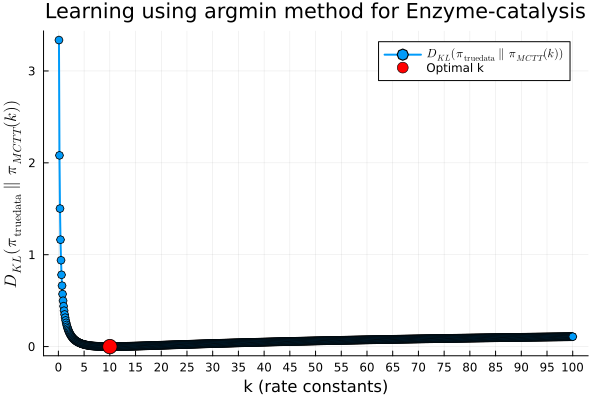

In [32]:
results_brute_force_ecr = []
#Computing stationary distributions for a range of k values spanned from 0.01 to 100.00
for t in 1:1000
    k=0.01+t*0.1
    model_data = mctt_for_crn_ecr(k, 12,4)
    
    divergence = kl_divergence(true_data, model_data)
    
    push!(results_brute_force_ecr, (k, divergence))
end
best_k, best_divergence = argmin([r[2] for r in results_brute_force_ecr]), minimum([r[2] for r in results_brute_force_ecr])
best_k = results_brute_force_ecr[best_k][1]

println("Best value of k: ", best_k)
println("Minimum KL divergence: ", best_divergence)

k_values = [r[1] for r in results_brute_force_ecr]
divergence_values = [r[2] for r in results_brute_force_ecr]

plot(k_values, divergence_values, xticks=0:5:100, marker=:o, xlabel="k (rate constants)", ylabel=L"D_{KL}(\pi_{\mathrm{true data}}\parallel \pi_{MCTT}(k))", title="Learning using argmin method for Enzyme-catalysis", label=L"D_{KL}(\pi_{\mathrm{true data}} \parallel \pi_{MCTT}(k))", lw=2, legend=:topright)
scatter!([best_k], [best_divergence], color=:red, label="Optimal k", marker=:circle, markersize=8)

Assuming if parameter comes from some distribution

Best value of k: 437.0
Minimum KL divergence: 0.21644654033886684


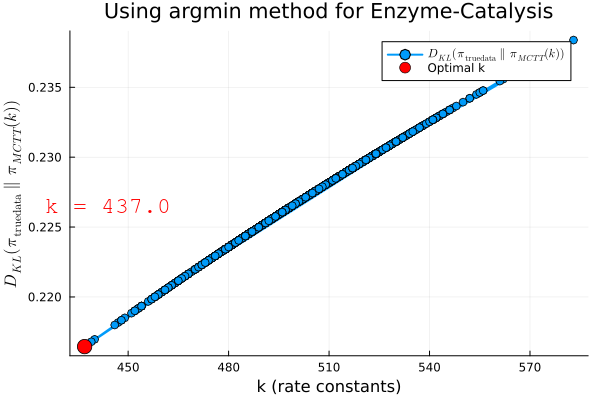

In [33]:
poisson_dist = Poisson(500)
results_poisson_ecr = []
for t in 1:1000
    k=float(rand(poisson_dist))
    model_predictions = mctt_for_crn_ecr(k, 12, 4)
    
    divergence = kl_divergence(true_data, model_predictions)
    
    push!(results_poisson_ecr, (k, divergence))
end

best_k, best_divergence = argmin([r[2] for r in results_poisson_ecr]), minimum([r[2] for r in results_poisson_ecr])
best_k = results_poisson_ecr[best_k][1]

println("Best value of k: ", best_k)
println("Minimum KL divergence: ", best_divergence)

k_values = [r[1] for r in results_poisson_ecr]
divergence_values = [r[2] for r in results_poisson_ecr]

plot(k_values, divergence_values, marker=:o, xlabel="k (rate constants)", ylabel=L"D_{KL}(\pi_{\mathrm{true data}}\parallel \pi_{MCTT}(k))", title="Using argmin method for Enzyme-Catalysis", label=L"D_{KL}(\pi_{\mathrm{true data}} \parallel \pi_{MCTT}(k))", lw=2, legend=:topright)
scatter!([best_k], [best_divergence], color=:red, label="Optimal k", marker=:circle, markersize=8)
annotate!(best_k + 7, best_divergence + 0.01, text("k = $(round(best_k, digits=2))", :red, :bold, 12))

5.3 Learning using gradient-descent with Automatic Differentiation

5.3.2 AD in A<->B

In [44]:
true_data = mctt_for_crn1(10.0,8)

9-element Vector{Float64}:
 0.4665073802097335
 0.37320590416778676
 0.13062206645872534
 0.026124413291745086
 0.0032655516614681465
 0.00026124413291746013
 1.3062206645880068e-5
 3.732059041740502e-7
 4.665073807467891e-9

Converged after 32970 iterations. Estimated k = 10.000000002917284
Final estimate of k: 10.000000002917284


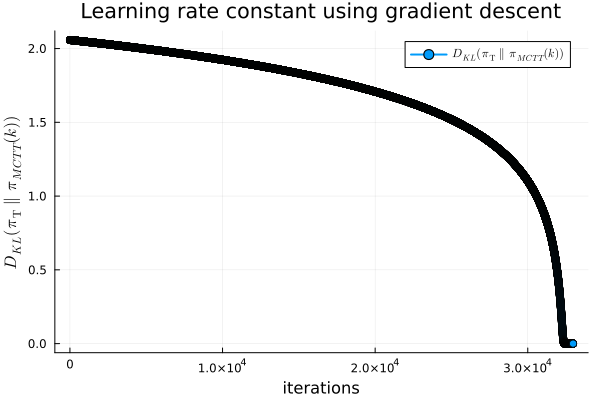

In [45]:
function objective_function_crn1(params::AbstractVector{<:Real})
    # params[1] may be Float64 or ForwardDiff.Dual
    k = params[1]
    model_data = mctt_for_crn1(k, 8)   
    T = eltype(model_data)   # Either Float64 or Dual{…}
    kl_div = zero(T)
    for i in 1:length(model_data)
        piT = T(true_data[i])                      # promote Float64 → T
        piM = model_data[i]                        # already T
        # add piT * log(piT/piM), protecting against zero in piM
        kl_div += piT * log( piT / max(piM, T(1e-10)) )
    end
    return kl_div
end
gradient_objective_crn1(params) = ForwardDiff.gradient(objective_function_crn1, params)
params = [float(rand(Poisson(500)))]
# Hyperparameters
learning_rate = 5.0
tolerance     = 1e-10
max_iters     = 50000
# For logging history
params_history = Float64[]
divergences   = Float64[]
for iter in 1:max_iters
    # 4.1) Compute gradient ∇ₖ D_KL(true_data ‖ model_data(k))
    grad = gradient_objective_crn1(params)
    # 4.2) Update:
    new_params = params .- learning_rate .* grad
    # 4.3) Record current k and its KL divergence
    push!(params_history, params[1])
    push!(divergences, objective_function_crn1(params))
    # 4.4) Check for convergence (in k‐space, since params is 1‐D)
    if norm(new_params .- params) < tolerance
        println("Converged after $iter iterations. Estimated k = $(new_params[1])")
        params = new_params
        break
    end
    # 4.5) Step forward
    params = new_params
end
println("Final estimate of k: ", params[1])
iters = 1:length(divergences)
plot(iters, divergences, marker=:circle, xlabel="iterations", ylabel=L"D_{KL}(\pi_{\mathrm{T}} \parallel \pi_{MCTT}(k))", title="Learning rate constant using gradient descent", label=L"D_{KL}(\pi_{\mathrm{T}} \parallel \pi_{MCTT}(k))", lw=2, legend=:topright)

5.3.3 AD in Enzyme-Catalysis

In [51]:
true_data = mctt_for_crn_ecr(10.0,12,4)

5-element Vector{Float64}:
 0.9241980972411532
 0.07393584777929227
 0.0018483961944823083
 1.760377328078486e-5
 5.501179150309591e-8

Here we will set learning rate equal to 50.0

Converged after 32975 iterations. Estimated k = 10.000000002485788
Final estimate of k: 10.000000002485788


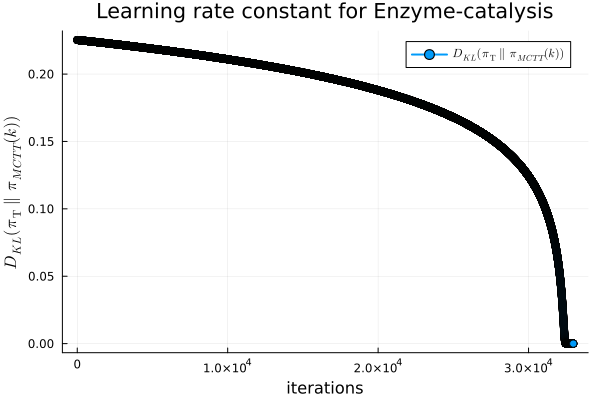

In [53]:
function objective_function_crn_ecr(params::AbstractVector{<:Real})
    # params[1] may be Float64 or ForwardDiff.Dual
    k = params[1]
    model_data = mctt_for_crn_ecr(k, 12, 4)   
    T = eltype(model_data)   # Either Float64 or Dual{…}
    kl_div = zero(T)
    for i in 1:length(model_data)
        piT = T(true_data[i])                      # promote Float64 → T
        piM = model_data[i]                        # already T
        # add piT * log(piT/piM), protecting against zero in piM
        kl_div += piT * log( piT / max(piM, T(1e-10)) )
    end
    return kl_div
end
gradient_objective_crn_ecr(params) = ForwardDiff.gradient(objective_function_crn_ecr, params)
params = [float(rand(Poisson(500)))]
# Hyperparameters
learning_rate = 50.0
tolerance     = 1e-10
max_iters     = 50000
# For logging history
params_history = Float64[]
divergences   = Float64[]
for iter in 1:max_iters
    # 4.1) Compute gradient ∇ₖ D_KL(true_data ‖ model_data(k))
    grad = gradient_objective_crn_ecr(params)
    # 4.2) Update:
    new_params = params .- learning_rate .* grad
    # 4.3) Record current k and its KL divergence
    push!(params_history, params[1])
    push!(divergences, objective_function_crn_ecr(params))
    # 4.4) Check for convergence (in k‐space, since params is 1‐D)
    if norm(new_params .- params) < tolerance
        println("Converged after $iter iterations. Estimated k = $(new_params[1])")
        params = new_params
        break
    end
    # 4.5) Step forward
    params = new_params
end
println("Final estimate of k: ", params[1])
iters = 1:length(divergences)
plot(iters, divergences, marker=:circle, xlabel="iterations", ylabel=L"D_{KL}(\pi_{\mathrm{T}} \parallel \pi_{MCTT}(k))", title="Learning rate constant for Enzyme-catalysis", label=L"D_{KL}(\pi_{\mathrm{T}} \parallel \pi_{MCTT}(k))", lw=2, legend=:topright)

5.4 Learning from Energy-Based models

5.4.2 Three Node Energy-Based Model

We will now define the function to compute probability ditribution of an energy based model with 2^n possible configurations. Later, we will see how we can also take any random arangements of nodes can also generate probability distributions. Here, we only take model with n nodes connected in a line.

In [72]:
#N-Node Boltzmann Machine
function N_node_straight_BM(N::Int64,biases,weights)
    num_states = 2^N
    states = [reverse(digits(i-1, base=2, pad=N)) for i in 1:num_states]
    Energies =[]
    for config in states
        Energy=0.0
        for i in 1:(N-1)
            Energy += weights[i] * config[i] * config[i+1]  # Interaction term
        end
        for i in 1:N
            Energy += biases[i] * config[i]  # Bias term
        end
        push!(Energies, Energy)
    end
    Z = sum(exp(-E) for E in Energies)
    # Probabilities Q for each configuration
    Q = [exp(-E) / Z for E in Energies]
    labels = [string(states[i]) for i in 1:length(states)]
    #display(bar(labels, Q, xlabel="States", ylabel=L"T(x)", legend=:topright, title="Target Distribution: Three Node EBM", label = L"T"))
    #We can also use above line to see the distribution in histogram
    return Q
end
# Example usage for N = 3
N = 3
biases = [0.5, 0.3, 0.8]  # Example biases
weights = [0.4, 0.2]      # Example weights (pairwise interactions)
true_data = N_node_straight_BM(N, biases, weights)
println("True Data: ", true_data)

True Data: [0.26640106119596224, 0.11970171286691027, 0.1973547601429142, 0.0726027588738993, 0.1615804113953326, 0.0726027588738993, 0.08023845767949218, 0.029518078971590003]


Defining CRN for EBM with N=3:

In [73]:
crn_ebm = @reaction_network begin
    1.0, X₁⁰ --> X₁¹
    1.0, X₁¹ --> X₁⁰
    1.0, X₂⁰ --> X₂¹
    1.0, X₂¹ --> X₂⁰
    1.0, X₃⁰ --> X₃¹
    1.0, X₃¹ --> X₃⁰
    k₁₂, X₁¹+X₂⁰ --> X₁¹+X₂¹
    1.0, X₁¹+X₂¹ --> X₁¹+X₂⁰
    k₂₁, X₂¹ + X₁⁰ --> X₂¹ + X₁¹
    1.0, X₂¹ + X₁¹ --> X₂¹ + X₁⁰
    k₂₃, X₂¹ + X₃⁰ --> X₂¹ + X₃¹
    1.0, X₂¹ + X₃¹ --> X₂¹ + X₃⁰
    k₃₂, X₃¹+X₂⁰ --> X₃¹+X₂¹
    1.0, X₃¹+X₂¹ --> X₃¹+X₂⁰
end

Model ##ReactionSystem#294
States (6):
  X₁⁰(t)
  X₁¹(t)
  X₂⁰(t)
  X₂¹(t)
⋮
Parameters (4):
  k₁₂
  k₂₁
  k₂₃
  k₃₂

In [74]:
function mctt_for_crn_ebm(N::Int64, rates_fwd::Dict{Tuple{Int64, Int64}, T}, rates_bwd::Dict{Tuple{Int64, Int64}, T}) where T<:Real
    num_states = 2^N
    config = [reverse(digits(i-1, base=2, pad=N)) for i in 1:num_states]
    P = zeros(T, num_states, num_states)
    for i in 1:num_states
        current_state = config[i]
        # Single node transitions: Xi^0 <--> Xi^1 with rate 1
        for v in 1:N
            new_state = copy(current_state)
            new_state[v] = 1 - current_state[v]  # Flip the bit for node v (state transition)
            new_index = 1 + parse(Int, join(new_state), base=2)  # Get the new state index
            # Add transition rate for single vertex flipping
            # Rate is 1 for each node
            P[i, new_index] += 1.0
            P[i, i] -= 1.0  # Update diagonal
        end
         # Coupled transitions: X_i^1 + X_j^0 <--> X_i^1 + X_j^1
         for (pair, rate_fwd) in rates_fwd
            i1, j1 = pair
            if current_state[i1] == 1 && current_state[j1] == 0
                new_state = copy(current_state)
                new_state[j1] = 1
                new_index = 1 + parse(Int, join(new_state), base=2)
                P[i, new_index] += rate_fwd  # Transition rate a_ij
                # Fill diagonal
                P[i, i] -= rate_fwd
            end
        end
        for (pair, rate_bwd) in rates_bwd
            i1, j1 = pair
            if current_state[i1] == 1 && current_state[j1] == 1
                new_state = copy(current_state)
                new_state[j1] = 0
                new_index = 1 + parse(Int, join(new_state), base=2)
                P[i, new_index] += rate_bwd  # Transition rate b_ij
                # Fill diagonal
                P[i, i] -= rate_bwd
            end
        end
    end
    z = Vector{T}(undef, num_states)
    for i in 1:num_states
        rows = collect(1:num_states) .!= i
        cols = collect(1:num_states) .!= i
        minor = P[rows, cols]
        z[i] = det(minor)
    end
    s = sum(z)
    z = z ./ s
    labels = [string(config[i]) for i in 1:length(config)]
    #display(bar(labels, z , xlabel="States", ylabel=L"\pi_{MCTT}", legend=:topright, title="Stationary Distribution by CRN_EBM", label = L"\pi_{MCTT}"))
    #One can also use the above line to get the histogram representation of stationary distribution
    return z
end
N = 3  # Number of pairs
rates_fwd = Dict((1, 2) => 3.0, (2, 1) => 2.0, (2,3) => 1.5, (3,2) => 2.5) 
rates_bwd = Dict((1,2) => 1.0, (2,1) => 1.0, (2,3) => 1.0, (3,2) => 1.0) #we will keep backward rates to be 1.0 only for now
demonstrated_data = mctt_for_crn_ebm(N, rates_fwd, rates_bwd)

8-element Vector{Float64}:
 0.09540387247485604
 0.08658805745010663
 0.11112174908481873
 0.14302773680354852
 0.08850181088964297
 0.09477496989363293
 0.17041601148468435
 0.21016579191871004

Converged after 18462 iterations. Estimated parameters = [-0.2942562269269478, -0.3568625060430096, -0.7275096812427582, 0.8067337109964272]
Optimal values of parameters: [-0.2942562269269478, -0.3568625060430096, -0.7275096812427582, 0.8067337109964272]


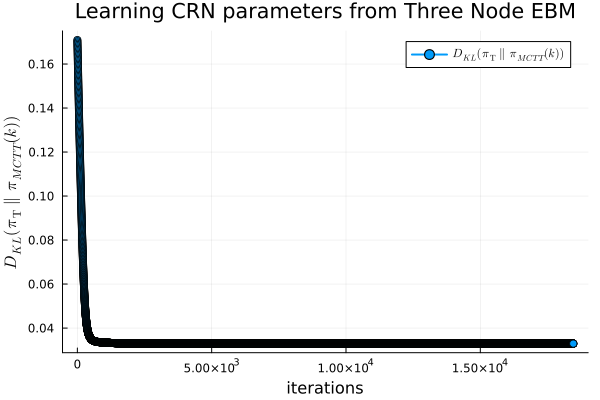

In [86]:
function objective_function_crn_ebm(params::AbstractVector{<:Real})
    T = eltype(params)
    # forward rates come from params (already type T)
    rates_fwd = Dict((1,2) => params[1],(2,1) => params[2],(2,3) => params[3],(3,2) => params[4])
    # backward rates are “1.0” constants, lift them to type T
    rates_bwd = Dict((1,2) => T(1.0), (2,1) => T(1.0), (2,3) => T(1.0), (3,2) => T(1.0))
    model_data = mctt_for_crn_ebm(3, rates_fwd, rates_bwd)   
    # now both dicts have element‐type T
    model_data = mctt_for_crn_ebm(3, rates_fwd, rates_bwd)
    # compute KL divergence against your global true_data
    kl_div = zero(T)
    for i in eachindex(model_data)
        piT = T(true_data[i])
        piM = max(model_data[i], T(1e-10))
        kl_div += piT * log(piT/piM)
    end
    return kl_div
end
gradient_objective_crn_ebm(params) = ForwardDiff.gradient(objective_function_crn_ebm, params)
params = [1.0, 1.0, 1.0, 1.0]
# Hyperparameters
learning_rate = 0.1
tolerance     = 1e-10
max_iters     = 50000
# For logging history
params_history = Vector{Vector{Float64}}()  
divergences   = Float64[]
for iter in 1:max_iters
    # 4.1) Compute gradient ∇ₖ D_KL(true_data ‖ model_data(k))
    grad = gradient_objective_crn_ebm(params)
    # 4.2) Update:
    new_params = params .- learning_rate .* grad
    # 4.3) Record current k and its KL divergence
    push!(params_history, params)
    push!(divergences, objective_function_crn_ebm(params))
    # 4.4) Check for convergence (in k‐space, since params is 1‐D)
    if norm(new_params .- params) < tolerance
        println("Converged after $iter iterations. Estimated parameters = $(new_params)")
        params = new_params
        break
    end
    # 4.5) Step forward
    params = new_params
end
println("Optimal values of parameters: ", params)
iters = 1:length(divergences)
plot(iters, divergences, marker=:circle, xlabel="iterations", ylabel=L"D_{KL}(\pi_{\mathrm{T}} \parallel \pi_{MCTT}(k))", title="Learning CRN parameters from Three Node EBM", label=L"D_{KL}(\pi_{\mathrm{T}} \parallel \pi_{MCTT}(k))", lw=2, legend=:topright)

This set of optimal parameters contains optimal value of k12, k21, k23, k32.

Now, lets see if our two systems (EBM , CRN_EBM) are generating same distributions or not

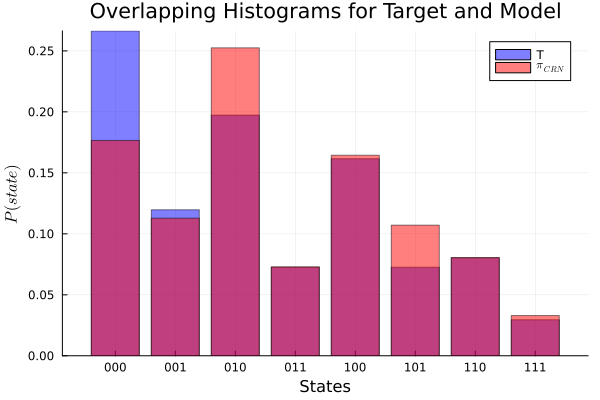

In [90]:
function optimal_parameters_crn_ebm(params::AbstractVector{<:Real})
    T = eltype(params)
    # forward rates come from params (already type T)
    rates_fwd = Dict((1,2) => params[1],(2,1) => params[2],(2,3) => params[3],(3,2) => params[4])
    # backward rates are “1.0” constants, lift them to type T
    rates_bwd = Dict((1,2) => T(1.0), (2,1) => T(1.0), (2,3) => T(1.0), (3,2) => T(1.0))
    model_data = mctt_for_crn_ebm(3, rates_fwd, rates_bwd)   
    return model_data
end
model_data = optimal_parameters_crn_ebm(params)
s = [join(reverse(digits(i-1, base=2, pad=3))) for i in 1:2^3]  # 3-bit binary states
# Bar plot with transparency
bar(s, true_data, label="T", color=:blue, alpha=0.5, xlabel="States", ylabel=L"P(state)")
bar!(s, model_data, label=L"\pi_{CRN}", color=:red, alpha=0.5)
title!("Overlapping Histograms for Target and Model")

Since, 000 doesn't involve any parameter for its production or consumption, so we can expect the wierd behaviour on this config. But, we are free to add more parameters in order to get the best approximation. So, we can say that this demonstration somehow helps us in realising that CRN can mimick the effects of Energy Based Models.